# Introduction to Pit30M

Welcome to Pit30M! To get started, go through these tutorial notebooks in order.


Note that you don't need to download anything---the `pit30m` development kit is cloud-native, which means you can use it to directly access the dataset. There are good reasons for this--the total dataset size is well over 100TB!


### Technical Notes
But don't worry, the dataset has been designed to be cloud-friendly. For example, we provide a PyTorch dataloader which can be used to train and evaluate various models (deep or non-deep). Even modest AWS instances can read hundreds of images a second using the devkit, obviating the need for local copies.

In terms of **programming languages**, while the devkit and related tooling is all Python, as Python has become the *lingua franca* of computer vision and machine learning in the recent years, the devkit is structured in plain formats like individual images files, CSV files, etc., so it can be read from any language which can talk to S3 (so, most languages).

If you do want to copy the dataset, you can always use the [AWS CLI](https://docs.aws.amazon.com/cli/latest/userguide/getting-started-quickstart.html) to `aws s3 sync ...` all or parts of the dataset to wherever you like, such as an on-prem cluster. However, using S3 directly is recommended due to its speed, space efficiency, and convenience. Please refer to the project `README.md` at the root of this repository for more information!


### AWS Open Data
AWS provides credit initiatives to researchers interested in working with open datasets (TBD links - ask AWS contacts!)


### Credits
The set of tutorials is inspired by the great documentation of [the Boreas dataset](https://www.boreas.utias.utoronto.ca/).

In [3]:
from datetime import datetime

import matplotlib.pyplot as plt
import numpy as np 
import os

%matplotlib inline

from pit30m.data.log_reader import LogReader
from pit30m.camera import CamName
from pit30m.cli import Pit30MCLI

## Reading Images

We will now show how to do basic I/O using the low-level interface of Pit30M: the log reader. In later tutorials we will check out some more interesting abstractions, like leveraging a PyTorch dataloader to read data in parallel at scale for evaluating computer vision algorithms, doing 3D reconstruction, or training neural networks.

In [4]:
# Select a log at random for exploration purposes
#
# Note that some logs may not have all sensors. For training models we will start with pre-built
# indexes in a bit. Now we just want to directly explore the data.
cli = Pit30MCLI()
sample_log_id = cli.all_log_ids[160]

lr = LogReader(log_root_uri=os.path.join("s3://pit30m/", sample_log_id))

In [16]:
lr

Pit30M Log Reader: s3://pit30m/1cfc29c3-faab-4dda-cf53-fdd46c0120ef

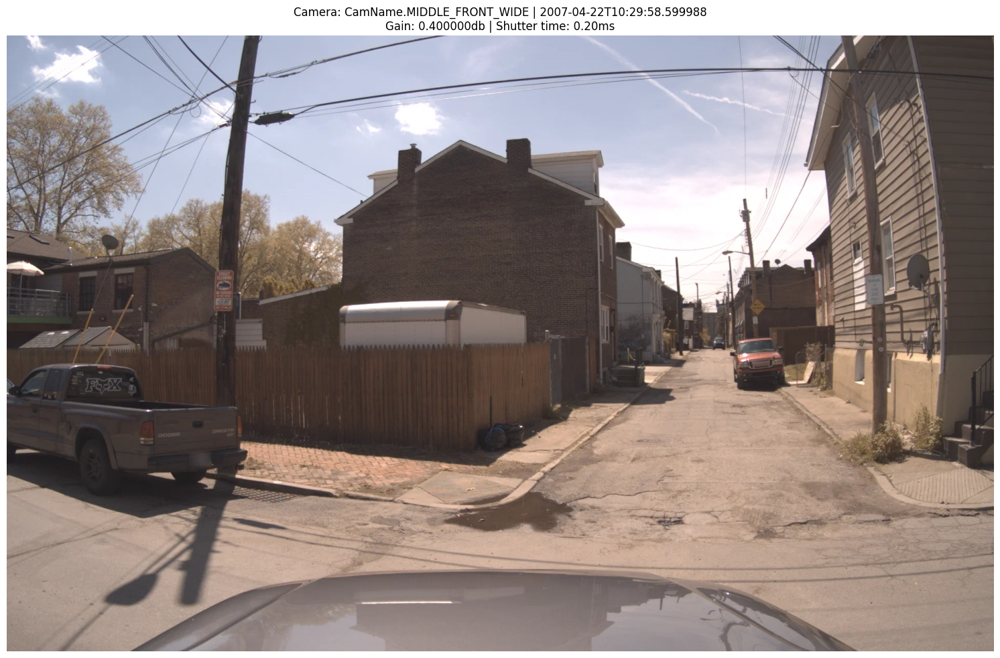

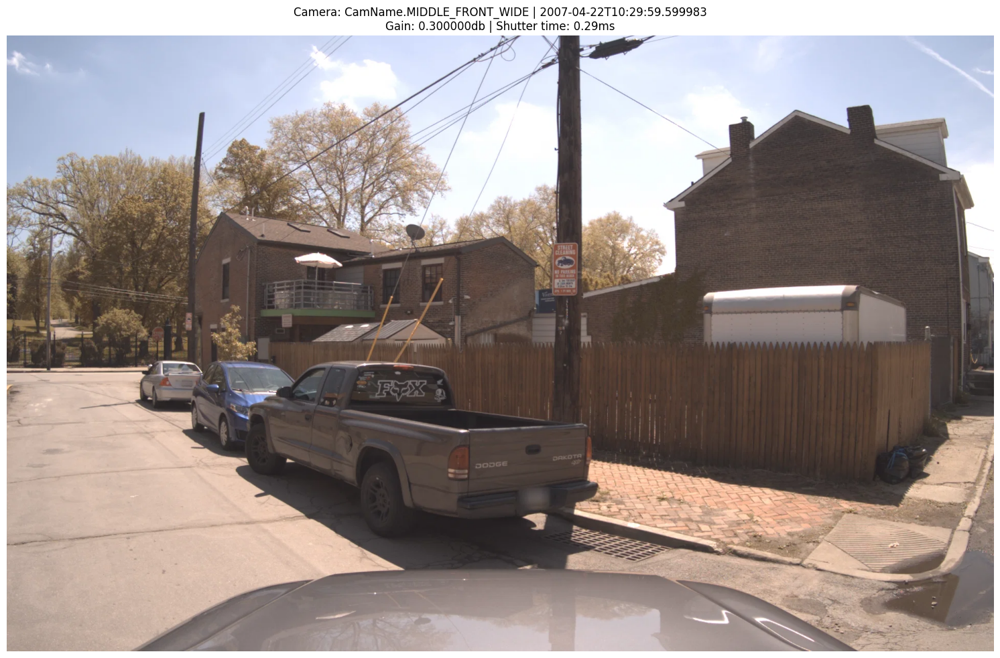

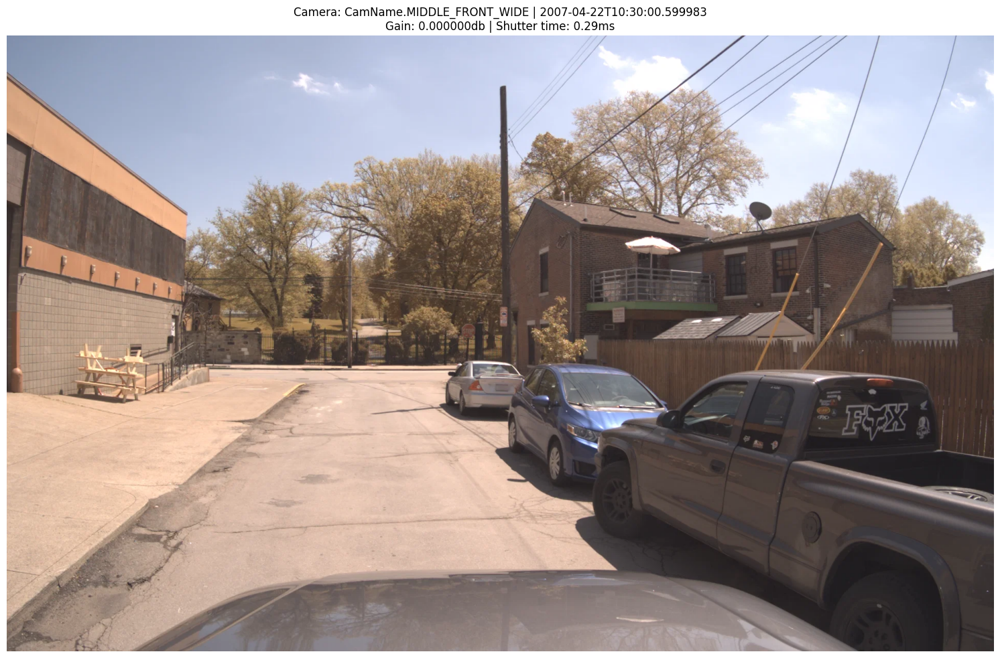

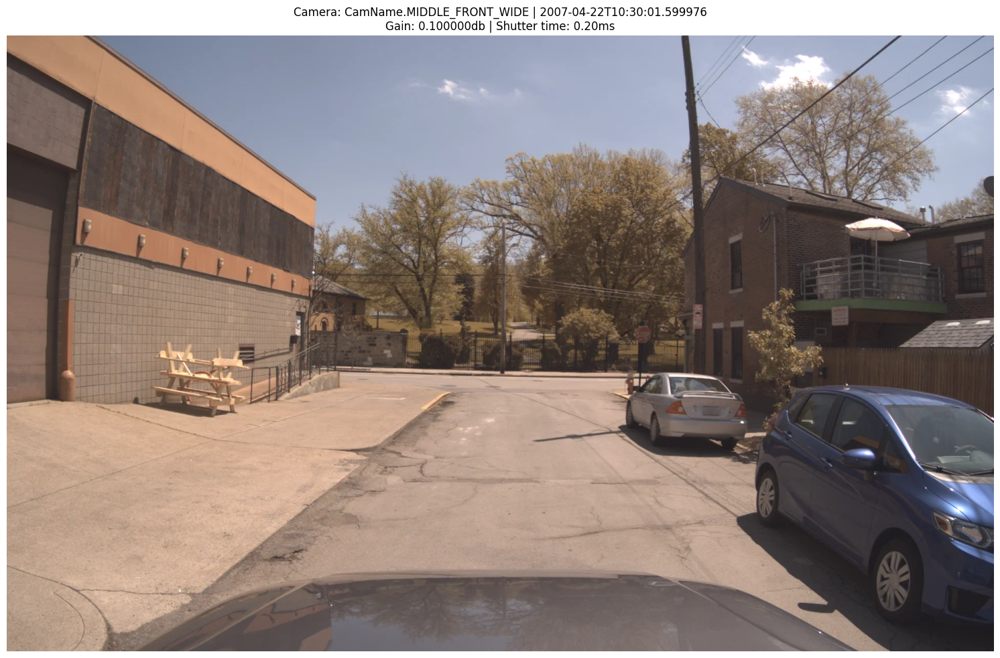

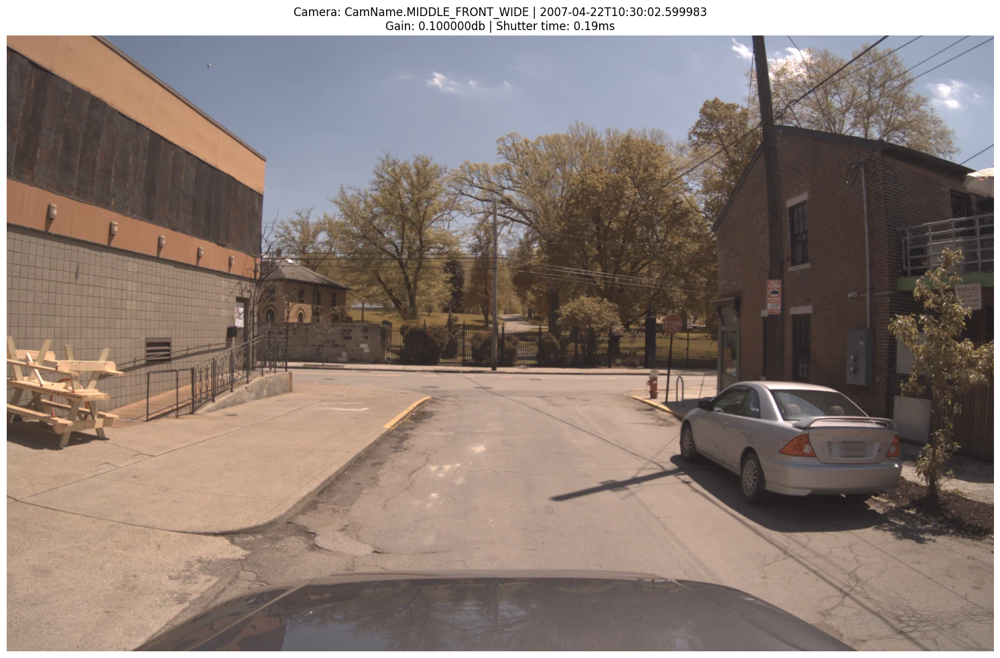

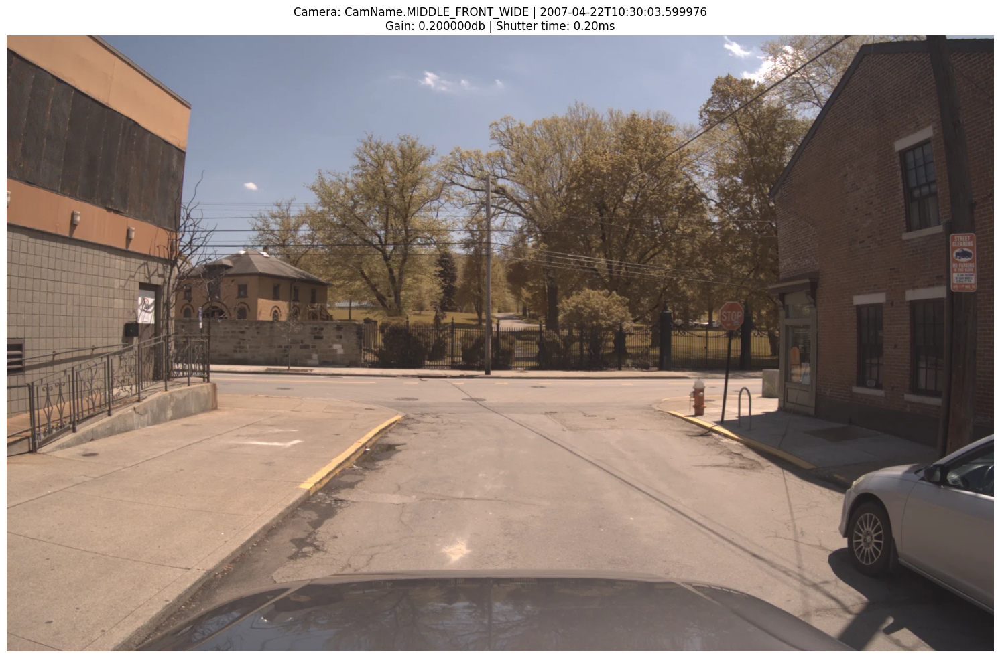

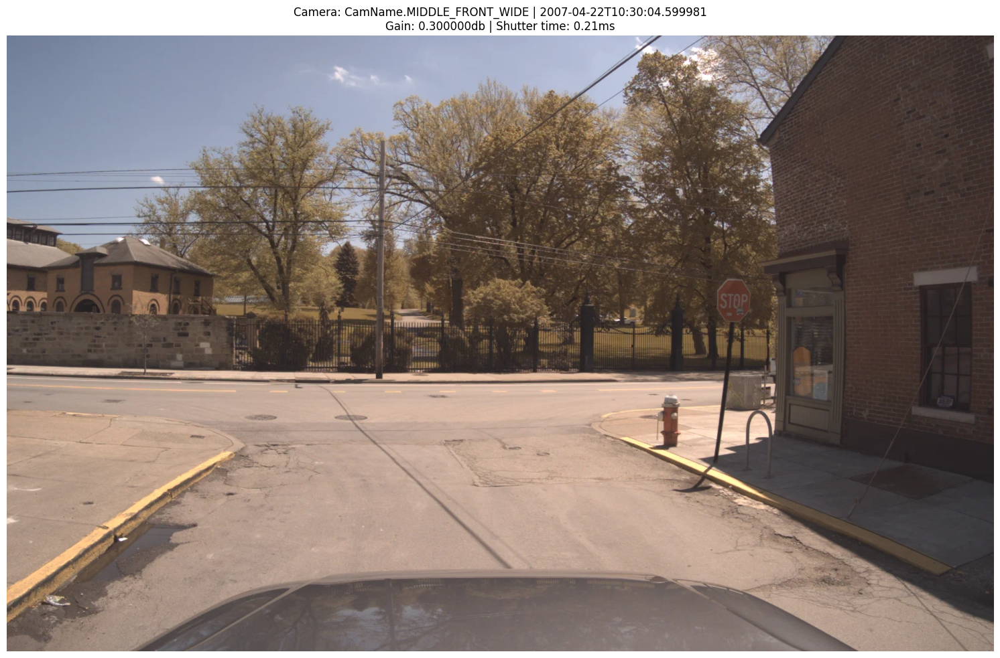

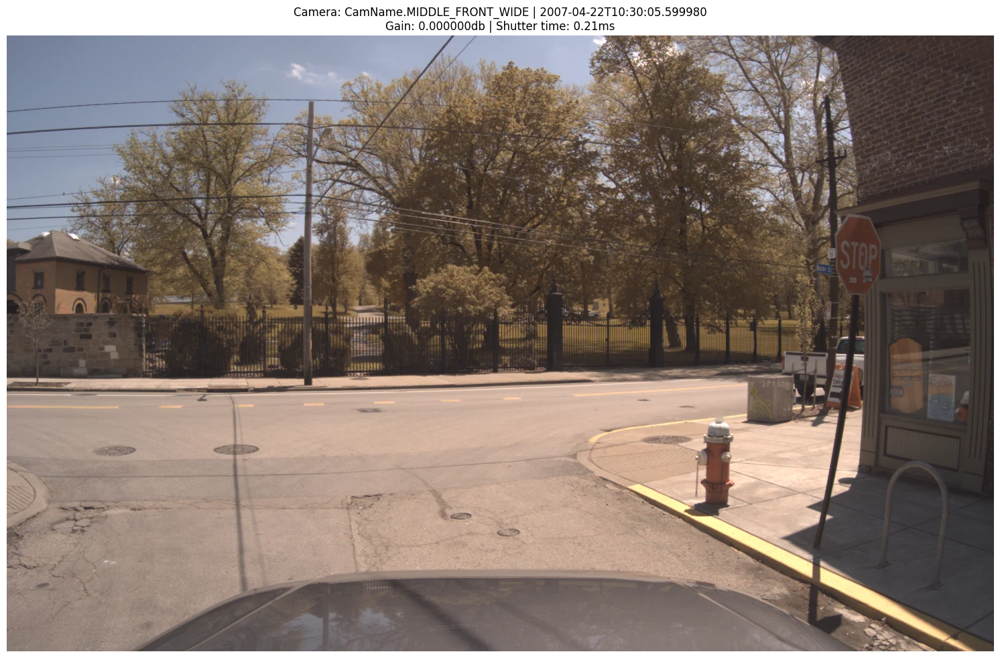

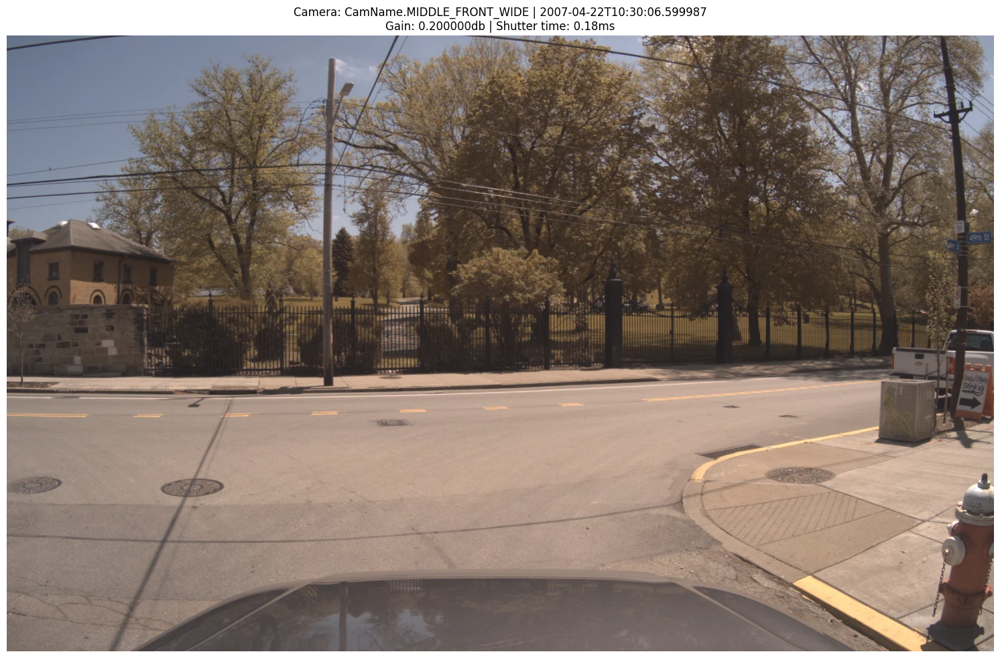

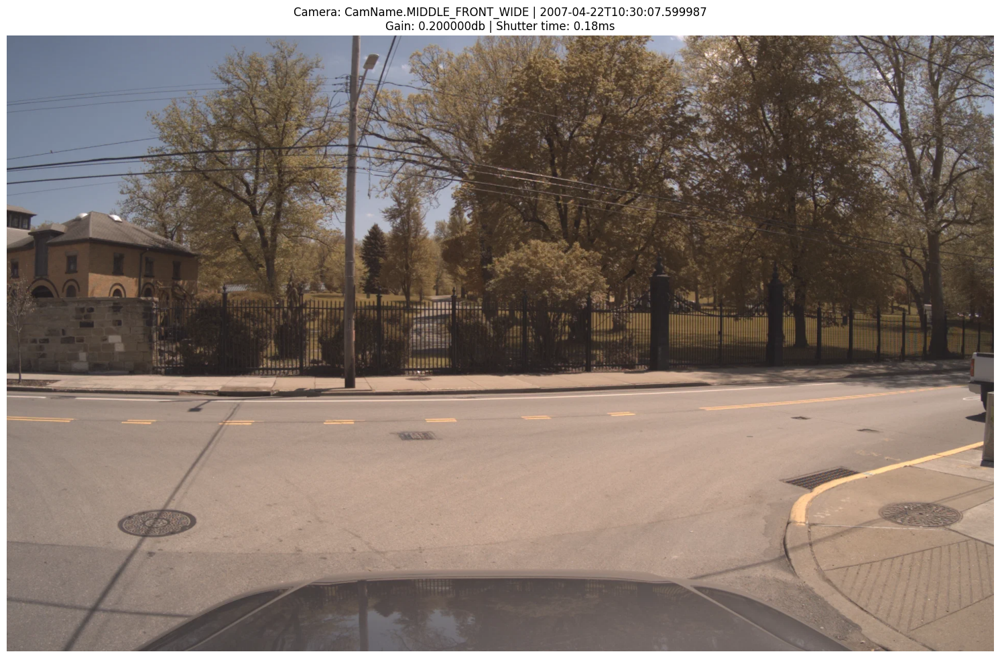

In [5]:
cam_it = lr.camera_iterator(CamName.MIDDLE_FRONT_WIDE, start=5000, step=10)
for idx, cam_img in enumerate(cam_it):
    if idx >= 10:
        break
    
    capture_date = datetime.fromtimestamp(cam_img.capture_timestamp)
    pretty_capture_time = datetime.isoformat(capture_date)
    plt.figure(figsize=(19, 12))
    plt.axis("off")
    plt.imshow(cam_img.image)
    plt.title(f"Camera: {cam_img.cam_name} | {pretty_capture_time}\n" \
              f"Gain: {cam_img.gain_db:4f}db | Shutter time: {cam_img.shutter_time_s * 1000:.2f}ms")

# Reading (Lots of) Poses

Let's plot the GPS and the refined tracks.

The raw WGS84 (raw GPS) will be noisy as it doesn't leverage LIDAR localization. True poses will match the roads very, very well.

In [11]:
# import folium
# from numpy.lib import recfunctions as rfn

# gps_track_lonlat = rfn.structured_to_unstructured(lr.raw_wgs84_poses_dense[["longitude", "latitude"]])
# gps_times = lr.raw_wgs84_poses_dense["timestamp"]
# centroid = np.median(gps_track_lonlat, axis=0)
# print(centroid)

# # TODO(andrei): Plot WGS84 alongside nice MRP to highlight GPS drift
# # TODO(andrei): Use path plotting since it looks way better when we downsample.
# m = folium.Map(location=centroid, zoom_start=15)
# # Avoid making folium too slow
# sample_rate = 5
# for gps_timestamp, (lon, lat) in zip(gps_times[::sample_rate], gps_track_lonlat[::sample_rate]):
#     popup = f"{lr.log_id}, GPS time {gps_timestamp}"
#     folium.CircleMarker(radius=2, location=(lon, lat), popup=popup).add_to(m)

# m

## Reading LiDAR

Let's now iterate through a log's LiDAR data and visualize it.

For convenience, we use `matplotlib` for a "hello world" view of the LiDAR. For any larger scale visualization, we strongly encourage the use of `open3d` which can support GPU-accelerated large-scale visualization tens or hundreds of times faster than matplotlib. In practice, you can visualize >100 sweeps at once without any downsampling at 60 FPS on a decent GPU, whereas matplotlib struggles with even just one sweep most of the time.

1177259781.2938697


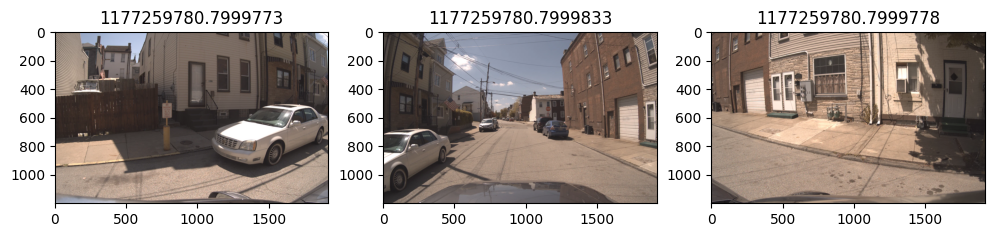

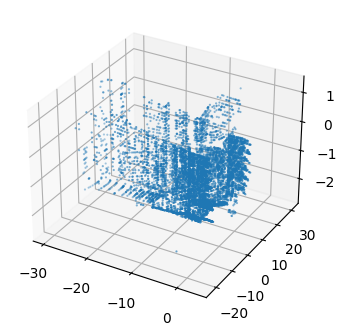

In [10]:
%matplotlib inline

c_l = lr.get_image(CamName.PORT_FRONT_WIDE, idx=0)
c_r = lr.get_image(CamName.STARBOARD_FRONT_WIDE, idx=0)
c_m = lr.get_image(CamName.MIDDLE_FRONT_WIDE, idx=0)
plt.figure(figsize=(12, 4))
plt.subplot(1, 3, 1)
plt.imshow(c_l.image)
plt.title(c_l.capture_timestamp)

plt.subplot(1, 3, 2)
plt.imshow(c_m.image)
plt.title(c_m.capture_timestamp)

plt.subplot(1, 3, 3)
plt.imshow(c_r.image)
plt.title(c_r.capture_timestamp)

sweep_0 = lr.get_lidar(idx=0)
sweep_1 = lr.get_lidar(idx=1)

print(sweep_0.point_times.mean())
xyz = sweep_0.xyz_sensor
mask = (xyz[:, 0] < 30) & (xyz[:, 0] > -30)
mask = mask & (xyz[:, 1] < 40) & (xyz[:, 1] > -40)
xyz = xyz[mask, ...]
figsize = (9, 4)
fig = plt.figure(figsize=figsize)
ax = fig.add_subplot(projection='3d')
ax.scatter(
    xs=xyz[::5, 0],
    ys=xyz[::5, 1],
    zs=xyz[::5, 2],
    s=0.33,
)
ax.set_aspect("auto")